<img src="02_images/itam_01.jpg" width="600" align="left">

# <center>**Esquema de compresión de Audio por medio de PCA**</center>
## <center>*Proyecto Final Estadística Multivariada y Datos Categóricos*</center>
   ### Alexis Solis Cancino - 130502 ###
   ### René Rosado González - 137085 ###
   ### José Carlos Escobar Gutiérrez - 175895 <p style='text-align: right;'> 20-Mayo-2019 </p>   ### 


# Introducción <br>
<p style='text-align: justify;'>El presente trabajo realiza un análisis de componentes principales para la compresión de archivos de audio. Por su naturaleza, los archivos de audio suelen ser extremadamente robustos y en consecuencia la transmisión y análisis de información de los mismos implica un elevado costo computacional.<br>
<br>
El formato de audio digital *waveform* (.wav) cuenta con la información discretizada de de las ondas de sonido recavadas en cantidades de alrededor de 10.5 MB por minuto. Si bien la tecnología disponible permite que el almacenamiento sea barato, siguen siendo objectos con una cantidad increíble de datos. Dentro de estos datos generalmente existen ruidos blancos que no son elementales para la construcción del audio de interés. Al realizar la compresión del audio se requiere rescatar la mayor cantidad de información de la onda de sonido de interés, discriminando el ruido blanco.  Por otra parte para poder leer y escribir estos archivos es necesario tener instalado el codificador-decodificador (*codec*) correspondiente a cada formato.<br>
<br>

Hay dos formas generales de lograr esto:<br><br>

   1. Compresión sin pérdida: los formatos *FLAC, ALAC y Monkey's Audio* (.ape) pasan por esta ruta. La idea es que cuando comprimes y descomprimes un archivo, obtienes exactamente lo mismo que con lo que empezaste.<br> <br>
   
   
   2. Compresión con pérdida: los formatos como *MP3, Ogg y AAC* (.m4a) son mucho más populares, pero hacen una compensación crucial: podemos reducir el tamaño del archivo aún más durante la compresión, pero el archivo descomprimido no será el mismo.<br>
   <br>

El uso de la compresión con pérdida sacrifica parte de la integridad del archivo resultante para ahorrar espacio de almacenamiento.  Como resultado se obtienen archivos que ocupan una décima parte del espacio  y la pérdida de información, si la compresión es exitosa, generalmente no es perceptible para el oido humano.<br><br>

En este proyecto utiliza el enfoque de PCA para codificar audio rescatando la mejor calidad posible mediante los componentes obtenidos, teniendo como externalizad un proceso llamado Reducción de Dimensionalidad. En pocas palabras, la idea es lo mismo que la compresión con pérdida: si podemos encontrar una forma que represente los datos lo suficientemente bien, podemos ahorrar espacio. Hay muchas preocupaciones teóricas que me llevan a creer que este estilo de compresión no terminará bien, pero estoy interesado en probarlo.<br><br>

PCA funciona de la siguiente manera: dado un conjunto de datos con una serie de características, encuentro una manera de aproximar esas características originales utilizando algunas "características nuevas" que son estadísticamente lo más cercanas posible a las originales. Esto es comparable a un esquema como MP3: dada una señal original, quiero encontrar una forma de representarlo que se aproxime aproximadamente a lo que era el original. La diferencia es que la PCA está diseñada para datos estadísticos y no para datos de señales. <br><br>

La idea es la siguiente: <br><br>
   1. Tomar una señal. <br>
   2. Modificarla en 1024 columnas, se necesitan muchas filas (rellenado con cero si es necesario).<br>
   3. Hacer PCA y realizar la reducción de la dimensionalidad con un par de configuraciones diferentes.<br><br>

El número de componentes que escoja determinará la calidad: si uso 1024 componentes, esencialmente usaré la señal original.  Si uso un número menor de componentes, comienzo a perder algunos de los datos que estaban en el archivo original. Esto me dará una idea de si es posible construir un esquema de codificación a partir de esto.<br><br>

El audio tiene 2 características principales, la tasa de muestreo (qué tan seguido estaremos extrayendo información de la señal análoga) y el tamaño de la mestra (la escala que utilizaré para representar la amplitud de la señal en cada instante).  El CD de musica tiene una tasa de muestreo de 44.1kHz con tamaños de muestra de 16bits (65536 valores posibles).  Cada segundo de audio entonces contiene 44,100 muestras de 16bits.
</p>

# Antecedentes #

## Magnitudes físicas del sonido ##

<p style='text-align: justify;'>Como todo movimiento ondulatorio, el sonido puede representarse mediante la Transformada de Fourier como una suma de curvas sinusoides, tonos puros, con un factor de amplitud, que se pueden caracterizar por las mismas magnitudes y unidades de medida que a cualquier onda de frecuencia bien definida: Longitud de onda *λ*, frecuencia *f* inversa del período *T*, amplitud (relacionada con el volumen y la potencia acústica) y fase.<br><br>
Esta descomposición simplifica el estudio de sonidos complejos ya que permite estudiar cada componente frecuencial independientemente y combinar los resultados aplicando el principio de superposición, que se cumple porque la alteración que provoca un tono no modifica significativamente las propiedades del medio. <br><br>

La caracterización de un sonido arbitrariamente complejo implica analizar:<br><br>

   1. Potencia acústica: El nivel de potencia acústica (PWL Power Wattage Level) es la cantidad de energía radiada al medio en forma de ondas por unidad de tiempo por una fuente determinada. La unidad en que se mide es el vatio y su símbolo es W. La potencia acústica depende de la amplitud.<br><br>
   2. Espectro de frecuencias: la distribución de dicha energía entre las diversas ondas componentes.
</p>

## Espectro Audible ##

<p style='text-align: justify;'>El espectro audible, también denominado campo tonal, se encuentra conformado por las audiofrecuencias, es decir, toda la gama de frecuencias que pueden ser percibidas por el oído humano.<br>
   <br>

Un oído sano y joven es sensible a las frecuencias comprendidas entre los 20 Hz y los 20 kHz. No obstante, este margen varía según cada persona y se reduce con la edad (llamamos presbiacusia a la pérdida de audición con la edad). Este rango equivale muy aproximadamente a diez octavas completas (210=1024). Frecuencias más graves incluso de hasta 4 ciclos por segundo son perceptibles a través del tacto, cuando la amplitud del sonido genera una presión suficiente.<br>
   <br>

   Fuera del espectro audible:<br>
   <br>
   1. Por encima estarían los ultrasonidos (Ondas acústicas de frecuencias superiores a los 20 kHz).<br>
   2. Por debajo, los infrasonidos (Ondas acústicas inferiores a los 20 Hz).<br>
   3. No hay que confundir las audiofrecuencias con las radiofrecuencias. Las audiofrecuencias son ondas mecánicas (por consiguiente, no se pueden propagar en el vacío, es decir, no tienen capacidad radiante), mientras que las radiofrecuencias son ondas electromagnéticas (por tanto, con capacidad radiante).<br><br>

El espectro audible varía según cada persona y se altera con la edad por eso es muy importante cuidarlo y no exponerlo a sonidos o ruidos muy fuertes que pueden dañarlo irremediablemente.<br><br>

El espectro audible podemos subdividirlo en función de los tonos:<br><br>

   1. Tonos graves (frecuencias bajas, correspondientes a las 4 primeras octavas, esto es, desde los 16 Hz a los 256 Hz).<br>
   2. Tonos medios (frecuencias medias, correspondientes a las octavas quinta, sexta y séptima, esto es, de 256 Hz a 2 kHz).<br>
   3. Tonos agudos (frecuencias altas, correspondientes a las tres últimas octavas, esto es, de 2 kHz hasta poco más de 16 kHz).<br>
</p>


## Teorema de Muestreo ##

<p style='text-align: justify;'>El teorema de muestreo de Nyquist-Shannon, también conocido como teorema de muestreo de Whittaker-Nyquist-Kotelnikov-Shannon o bien teorema de Nyquist, es un teorema fundamental de la teoría de la información, de especial interés en las telecomunicaciones.<br><br>

El teorema demuestra que la reconstrucción exacta de una señal periódica continua en banda base a partir de sus muestras, es matemáticamente posible si la señal está limitada en banda y la tasa de muestreo es superior al doble de su ancho de banda.<br><br>

Dicho de otro modo, la información completa de la señal analógica original que cumple el criterio anterior está descrita por la serie total de muestras que resultaron del proceso de muestreo. No hay nada, por tanto, de la evolución de la señal entre muestras que no esté perfectamente definido por la serie total de muestras.<br><br>

Si la frecuencia más alta contenida en una señal analógica $\displaystyle x_{a}(t)\,\!$ es $\displaystyle F_{max}=B\,\!$ y la señal se muestrea a una tasa $\displaystyle F_{s}>2F_{max}\equiv 2B\,\!$ , entonces $\displaystyle x_{a}(t)\,\!$ se puede recuperar totalmente a partir de sus muestras mediante la siguiente función de interpolación:<br><br>

<center>$\displaystyle g(t)={\frac {\sin 2\pi Bt}{2\pi Bt}}\,\!$</p>

Así, $\displaystyle x_{a}(t)\,\!$ se puede expresar como:<br><br>

<center>$\displaystyle x_{a}(t)=\sum _{n=-\infty }^{\infty }x_{a}\left({\frac {n}{F_{s}}}\right)g\left(t-{\frac {n}{F_{s}}}\right)$ <br><br>

donde $\displaystyle x_{a}\left({\frac {n}{F_{s}}}\right)=x_{a}\left(nT\right)\equiv x\left(n\right)$ son las muestras de $\displaystyle x_{a}\left(t\right)$.<br><br>

Hay que notar que el concepto de ancho de banda no necesariamente es sinónimo del valor de la frecuencia más alta en la señal de interés. A las señales para las cuales esto sí es cierto se les llama señales de banda base, y no todas las señales comparten tal característica (por ejemplo, las ondas de radio en frecuencia modulada).<br><br>

Si el criterio no es satisfecho, existirán frecuencias cuyo muestreo coincide con otras (el llamado aliasing).
<br><br>

## Aliasing ##

<p style='text-align: justify;'>
    El aliasing, o solapamiento, es el efecto que causa que señales continuas distintas se tornen indistinguibles cuando se muestrean digitalmente. Cuando esto sucede, la señal original no puede ser reconstruida de forma unívoca a partir de la señal digital. Una imagen limitada en banda y muestreada por debajo de su frecuencia de Nyquist en las direcciones $x$ y $y$, resulta en una superposición de las replicaciones periódicas del espectro $G(fx, fy)$. Este fenómeno de superposición periódica sucesiva es lo que se conoce como aliasing o Efecto Nyquist.
</p>

## Análisis de Componentes Principales ##

<p style='text-align: justify;'>El análisis de componentes principales (En inglés, PCA) es un procedimiento para la ortogonalización de datos correlacionados que permite obtener nuevas variables (llamadas "componentes") no correlacionadas. Los componentes se ordenan por la cantidad de varianza original que describen, por lo que la técnica es útil para reducir la dimensionalidad de un conjunto de datos. <br><br>

El método de PCA puede ser abordado como un problema de optimización donde la obtención de la primer componente principal se define como la solución de <br><br>

<center>$\displaystyle max_{\phi_{11},...,\phi_{1p}}={\frac {1}{n}\sum^n_{i=1}(\sum^p_{j=1}\phi_{1j}x_{ij})^2}\,\!$</p>
<br><br>

<center>$\displaystyle s.a \sum^p_{j=1}\phi^2_{1j}=1\,\!$</p> <br><br>

<p style='text-align: justify;'> Los componentes subsecuentes $\displaystyle {\phi_{2},...,\phi_{p}}\,\!$ se definen como la solución de la función objetivo a las resticciones anidadas $\displaystyle {<\phi_{j},\phi_{k}>=0}\,\!$ para $\displaystyle {k=1,...,(p-1)}\,\!$. <br><br>

El PCA se conforma por el cálculo de la descomposición en autovalores $\lambda_{i}$ de la matriz de covarianza, normalmente tras centrar los datos en la media de cada atributo. Los componentes principales como nuevas variables tienen las siguientes propiedades: <br><br>

  1. Conservan la variabilidad inicial, es decir, la suma de las varianzas de los componentes principales es igual a la suma de las varianzas de las variables originales.<br><br>
  <center>$\displaystyle traza(\Sigma)= \sum^P_{i=1} var(x_{i}) = \sum^P_{j=1} var(\lambda_{j}) \,\!$ </p><br><br>
  <p style='text-align: justify;'> 2. La proporción de variabilidad explicada por un componente es el cociente entre su varianza, el valor propio asociado al vector propio que lo define, y la suma de los valores propios de la matriz: <br><br>
  <center>$Proporción\space explicada\space por\space \lambda_k = \displaystyle {\frac {\lambda_k}{\lambda_1+...+\lambda_p}}\,\!$</p>
</p>

La idea central del análisis de componentes principales (_PCA_) es reducir la dimensionalidad de un conjunto de datos que consiste en un gran número de variables interrelacionadas, conservando al mismo tiempo, en la medida de lo posible, la variación presente en el conjunto de datos. Esto se logra transformando a un nuevo conjunto de variables, los componentes principales (_PCs_), que no están correlacionados, y que están ordenados de manera que los primeros retengan la mayor parte de la variación presente en todas las variables originales.

Supongamos que $x$ es un vector de $p$ variables aleatorias, y que las varianzas de las $p$ variables aleatorias y la estructura de las covarianzas o correlaciones entre las $p$ variables aleatorias son de interés. A menos que $p$ sea pequeño, o que la estructura sea muy simple, a menudo no será muy útil simplemente mirar las $p$ varianzas  y todos los valores de las  $\frac{p}{2}(p - 1)$ correlaciones o covarianzas. Un enfoque alternativo es buscar pocas ($m<p$) variables derivadas que conserven la mayor parte de la información proporcionada por estas varianzas y correlaciones o covarianzas.

Aunque la técnica de _PCA_ no ignora las covarianzas y correlaciones, se concentra en las varianzas. El primer paso es buscar una función lineal $\alpha_1 ' x$ de los elementos de $x$ con varianza máxima, donde $\alpha_1$ es un vector que contiene a las $p$ constantes: $\alpha_1 = (\alpha_{11}, \alpha_{12}, \ \ldots \ , \alpha_{1p})$ y $'$ denota transposición, por lo que:
\begin{equation*}
\alpha_1 ' x = \alpha_{11} x_1 + \alpha_{12}x_2 + \cdots +\alpha_{1p}x_p = \sum \limits_{j=1}^p a_{1j}x_j
\end{equation*}

El siguiente paso es encontrar una función lineal $\alpha_2 ' x$, **no-correlacionada** con $\alpha_1 ' x$, nuevamente con varianza máxima, y así sucesivamente, hasta llegar al $k$-ésimo paso y tener la función $\alpha_k ' x$ con máxima varianza y que sea **no-correlacionada** con las funciones $\alpha_1 ' x \ , \ \alpha_2 ' x \ , \ \alpha_3 ' x \ , \ldots \ , \ \alpha_{k-1} ' x$. La _k-ésima_ variable derivada de esta forma, $\alpha_k ' x$ es el _késimo_ componente principal (PC). Desde luego, pueden encontrarse $p$ componentes principales, pero se esperaría en general, que la mayor parte de la varianza de $x$ se encuentre mediante $m$ componentes principales, donde $m<<p$.

Ahora pasamos a un ejemplo donde $p = 2$. Es poco realista, pero la ventaja es que las variables aleatorias se pueden graficar fácilmente. Consideremos la siguiente figura, la cual contiene 50 observaciones de dos variables aleatorias $x_1$ y $x_2$. Podemos ver que existe bastante variazión en ambas variables, aunque en realidad hay un poco más de varianza en la dirección de $x_2$ que de $x_1$.

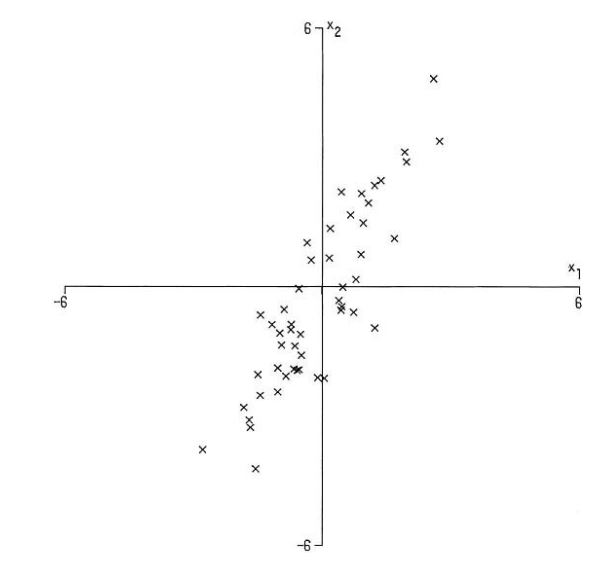

In [3]:
from IPython.display import Image

Image(filename="02_images/pca_01.JPG")

 Si ahora transformamos a componentes principales z1z1 y z2z2, obtenemos la siguiente figura:


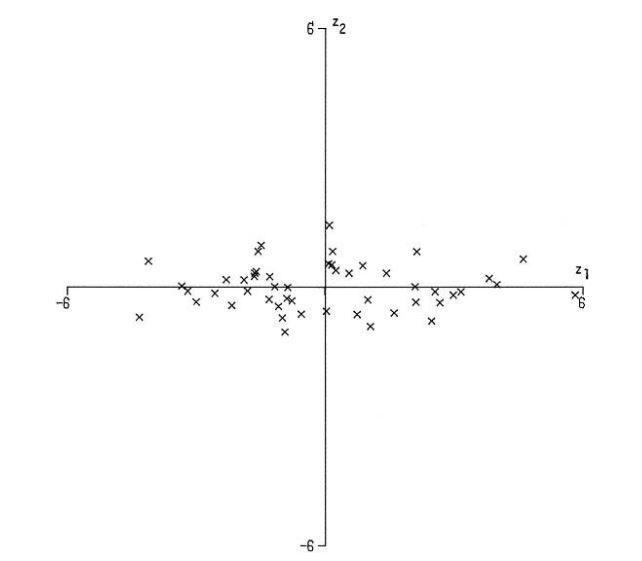

In [2]:
Image(filename="02_images/pca_02.JPG")

Donde se puede observar claramente que la mayoría de la variación ahora se encuentra en el primer componente principal $z_1$, y el segundo componente $z_2$ captura muy poca variación. Más generalmente, si un conjunto de $p>2$ variables aleatorias tienen correlaciones bastante altas entre ellas, entonces los primeros pocos componentes principales capturarán la mayor parte de la variación de las variables aleatorias originales. De igual forma, los últimos componentes principales identifican las direcciones en donde hay muy poca variación; lo cual también es importante puesto que dicho de otra forma, identifican relaciones lineales casi constantes entre las variables aleatorias.

Habiendo definido los componentes principales ahora debemos saber cómo encontrarlos. Consideremos por el momento el caso en el que el vector de variable aleatorias $x$ tiene una matriz de varianzas y covarianzas $\Sigma$. Esta es la matriz cuyos $(i,j)$-esimos elementos son las covarianzas entre el _i-esimo_ elemento de $x$ y el _j-esimo_ elemento de $x$, cuando $i \neq j$, y tiene la varianza del _j-esimo_ elemento de $x$ cuando $i = j$. En el caso realista en el que $\Sigma$ es desconocida, se puede reemplazar por una matriz de covarianzas muestrales.

Lo importante aquí es que, resulta ser que para $k = 1, 2, \ldots, p$, el _k-esimo_ componente principal está dado por $z_k =\alpha_k ' x$ , pero además $\alpha_k$ es un eigenvector de la matriz $\Sigma$ correspondiente al _k-esimo_ eigenvalor más grande $\lambda_k$. Más aún, si escogemos $\alpha_k$ de tal forma que sea un vector unitario (i.e. $\alpha_k' \alpha_k = 1$, entonces $\text{var}(z_k) = \lambda_k$; donde $\text{var}(z_k)$ denota la varianza de $z_k$.

Para derivar la forma de todos los componentes principales, consideremos el primero: $z_1 =\alpha_1 ' x$. Ahora bien, sabemos que el vector $\alpha_1$ maximiza la varianza que contienen el primer componente principal, i.e. maximiza: $\text{var}(z_1) = \text{var}(\alpha_1 ' x) = \alpha_1' \Sigma \alpha_1$. Sin embargo, debemos imponer la restricción de que $\alpha_1' \alpha_1 = 1$ para que el problema de maximización tenga solución finita (de otra forma, divergiría); es decir, necesitamos que la suma de cuadrados de $\alpha_1$ sea igual a 1.

Para resolver este problema de optimización, la técnica estándar es usar multiplicadores de Lagrange, es decir maximizar:

$$
\alpha_1' \Sigma \alpha_1 - \lambda (\alpha_1' \alpha_1 - 1),
$$

 donde $\lambda$ es el multiplicado de Lagrange. Derivar con respecto a $\alpha_1$ da como resultado:
 
 $$
 \Sigma \alpha_1 - \lambda \alpha_1 = 0
 $$
 
 o bien,
 
 $$
 (\Sigma - \lambda I_p)\alpha_1 =0
 $$
 
 , donde $I_p$ es una matriz identidad de dimensiones $(p \times p)$. POr lo tanto, $\lambda$ es un eigenvalor de $\Sigma$ y $\alpha_1$ es el eigenvector correspondiente. Para decidir cuál de los $p$ eigenvectores da $z_1 =\alpha_1 ' x$ con máxima varianza, notemos que la cantidad que se quiere maximizar es:
 
 $$
 \alpha_1' \Sigma \alpha_1 = \alpha_1' \lambda \alpha_1 = \lambda \alpha_1' \alpha_1  = \lambda
 $$
 , es decir $\lambda$ debe ser lo más grande posible. Por lo tanto, $\alpha_1$ es el eigenvector correspondiente al eigenvalor más grande de la matriz $\Sigma$ y $\lambda_1 =  \alpha_1' \Sigma \alpha_1 = \text{var}(\alpha_1 ' x)$ es el eigenvalor más grande.
 
 En general, el _k-esimo_ componente principal de $x$ es $z_k =\alpha_k ' x$ y $\text{var}(\alpha_k ' x) = \lambda_k$, donde $\lambda_k$ es el _k-esimo_ eigenvalor más grande de $\Sigma$ y $\alpha_k$ es el eigenvector correspondiente.
 
 A continuación, probaremos esta relación para $k = 2$; la prueba para $k \geq 3$ es ligeramente más compleja, pero muy similar.
 
 El segundo componente principal, $z_2 =\alpha_2 ' x$ maximiza $\alpha_2' \Sigma \alpha_2$, pero sujeto a que $z_2$ no esté correlacionado con $z_1$, o bien, que $\text{cov}[\alpha_1 ' x,\alpha_2 ' x] =0$. Sin embargo, observamos que:
 
 $$
 \text{cov}[\alpha_1 ' x,\alpha_2 ' x] = \alpha_1' \Sigma \alpha_2 = \alpha_2' \Sigma \alpha_1 = \alpha_2' \lambda \alpha_1' = \lambda_1 \alpha_2 ' \alpha_1 = \lambda_1 \alpha_1 ' \alpha_2
 $$
 
 Por lo tanto, cualquiera de las siguientes ecuaciones:
 $$
 \alpha_1' \Sigma \alpha_2 = 0, \quad \alpha_2' \Sigma \alpha_1 = 0, \quad \alpha_1' \alpha_2 = 0, \quad \alpha_2' \alpha_1 = 0
 $$
 
 podrían utilizarse para especificar correlación nula entre los dos primeros componentes principales $\alpha_1' x$ y $\alpha_2' x$. 

Escogiendo la última ecuación (lo cual es una decisión arbitraria) y notando que nuevamente se utiliza una restricción de normalización, la cantidad a maximizar es:
 
 $$
 \alpha_2' \Sigma \alpha_2 - \lambda (\alpha_2' \alpha_2 - 1) - \phi (\alpha_2' \alpha_1 - 0)
 $$
 
 , donde $\lambda$ y $\phi$ son multiplicadores de Lagrange. Derivando con respecto a $\alpha_2$ obtenemos:
 
 $$
  \Sigma \alpha_2 - \lambda \alpha_2 - \phi \alpha_1 = 0
 $$
 
 Ahora bien, multiplicando esta ecuación por $\alpha_1 '$ por la izquierda da como resultado:
 
 $$
   \alpha_1 '\Sigma \alpha_2 - \lambda \alpha_1 '\alpha_2 - \phi \alpha_1 ' \alpha_1 = 0
 $$
 
 cuya solución entonces es $\phi = 0$ dado que los primeros dos términos son igual a cero (por la ortogonalidad de los componentes principales) y $\alpha_1 ' \alpha_1 = 1$. Por lo tanto, la derivada del problema de maximización puede escribirse como:
 
 $$
 \Sigma \alpha_2 - \lambda \alpha_2 = 0
 $$
 o bien,
 $$
 (\Sigma - \lambda I_p)\alpha_2 =0
 $$
 
 , por lo que $\lambda$ nuevamente es un eigenvalor de la matriz $\Sigma$, y el vector $\alpha_2$ corresponde al eigenvector asociado.
 Notemos que nuevamente $\lambda =  \alpha_2' \Sigma \alpha_2$, así que $\lambda$ debe ser lo más grande posible. Asumiendo que $\Sigma$ no tiene eigenvalores repetidos, $\lambda$ no puede ser igual a $\lambda_1$. Si lo fuera, entonces podríamos concluir que $\alpha_2 = \alpha_1$, lo cual violaría la restricción de ortogonalidad: $\alpha_1' \alpha_2 = 0$. Por lo tanto, $\lambda$ debe ser **el segundo eigenvalor más grande** de $\Sigma$, y $\alpha_2$ es su eigenvector correspondiente.
 
 Como dijimos más arriba, se puede demostrar que para el tercer, cuarto, ... , _p-esimo_ componente principal, los vectores de coeficientes $\alpha_3, \alpha_4, \ldots, \alpha_p$ son eigenvectores de la matriz $\Sigma$ correspondientes a $\lambda_3, \lambda_4, \ldots, \lambda_p$, el tercer, cuarto más grande y, ... , el eigenvalor más pequeño, respectivamente. Además,
 
 $$
 \text{var}[\alpha_k' x] = \lambda_k \qquad \text{para } k = 1, 2, \ldots, p
 $$
 

## Procesamiento del Audio ##

Importamos algunas paqueterías necesarias.

In [1]:
from IPython.display import Audio
from scipy.io import wavfile
from sklearn.decomposition import PCA
import numpy as np
import pylab as pl
import sys
import seaborn as sns; sns.set()

<p style='text-align: justify;'>
    Importamos el archivo de Audio y lo mostramos.  Para fines prácticos, mostraremos los 15 primeros segundos a partir de los 23 segundos transcurridos.
    </p>

In [3]:
from IPython.display import Audio
from scipy.io import wavfile

#samplerate, tabulasa = wavfile.read('/home/joe/Music/Skrillex/Bangarang/bangarang.wav')
samplerate, tabulasa = wavfile.read('./first_notte.wav') 


start = samplerate * 23# 23 segundos transcurridos.
end = start + samplerate * 15 # Duración de 15 segundos.
Audio_orig = Audio(data=tabulasa[start:end, 0], rate=samplerate)
Audio_orig

C:\Users\rener\Anaconda3\lib\site-packages\scipy\io\wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


## PCA del Audio ##
<p style='text-align: justify;'>

A continuación proponemos una función para reducir la dimensionalidad de la señal por medio de PCA.  Primero le damos la dimensión adecuada a la señal del audio para poder hacer las operaciones matriciales de tal.  Posteriormente tomamos el numero de componentes dado para poder reconstrir la señal y transformarla en archivo de audio de vuelta.

</p>

In [4]:
from sklearn.decomposition import PCA
import numpy as np
import pylab as pl
import sys
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display

#@jit(nopython=True)
def reducir_pca(signal, n_components, block_size=1024):
    
    # Hacemos un zero-pad de la señal para que sea divisible por el tamaño de bloque.
    # Simplemente agregamos zeros en los espacios que queden vacíos.
    samples = len(signal)
    hanging = block_size - np.mod(samples, block_size)
    padded = np.lib.pad(signal, (0, hanging), 'constant', constant_values=0)
    
    # Hacemos que ahora la señal tenga 1024 dimensiones.
    reshaped = padded.reshape((len(padded) // block_size, block_size))
    
    # Con esta funcion hacemos la parte de PCA.
    pca = PCA(n_components=n_components)
    pca.fit(reshaped)
    
    transformed = pca.transform(reshaped)
    reconstructed = pca.inverse_transform(transformed).reshape((len(padded)))
    components = pca.components_
    expvar = pca.explained_variance_
    mean = pca.mean_
    singval = pca.singular_values_ 
    expvar_ratio = pca.explained_variance_ratio_
    return pca, transformed, reconstructed, components, expvar, mean, singval, expvar_ratio

   ## Descomposición y Reconstruccion de la Señal. ## 
<p style='text-align: justify;'>
Construimos varios salidas utilizando todos los componentes principales (1024), la mitad (512), el 20% (204) y finalmente una 64-va parte de los componentes (16).
</p>

In [5]:
tabulasa_left = tabulasa[:,0]
pca_orig, transformed_orig, reconstructed_orig, comp_orig, expvar_orig, mean_orig, singval_orig, expvarrat_orig = reducir_pca(tabulasa_left, 1024, 1024)
pca_512, transformed_512, reconstructed_512, comp_512, expvar_512, mean_512, singval_512, expvarrat_512 = reducir_pca(tabulasa_left, 512, 1024)
pca_204, transformed_204, reconstructed_204, comp_204, expvar_204, mean_204, singval_204, expvarrat_204 = reducir_pca(tabulasa_left, 204, 1024)
pca_16, transformed_16, reconstructed_16, comp_16, expvar_16, mean_16, singval_16, expvarrat_16 = reducir_pca(tabulasa_left, 16, 1024)

In [64]:
#Draw vectors.
def draw_vector(v0, v1, ax=None):
    ax = ax or plt.gca()
    arrowprops=dict(arrowstyle='->',
                    linewidth=2,
                    shrinkA=0, shrinkB=0)
    ax.annotate('', v1, v0, arrowprops=arrowprops)

def biplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.scatter(xs * scalex,ys * scaley, alpha = 0.3)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'g', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'g', ha = 'center', va = 'center')

In [53]:
range(1,len(comp_orig))

range(1, 1024)

   ### Señal Reconstruida con 1024 Componentes Principales. ### 
   A continuación mostramos la Forma de Onda, el Audio, el Espectrograma y los Componentes Principales de la señal procesada usando todos los 1024 Componentes Principales.

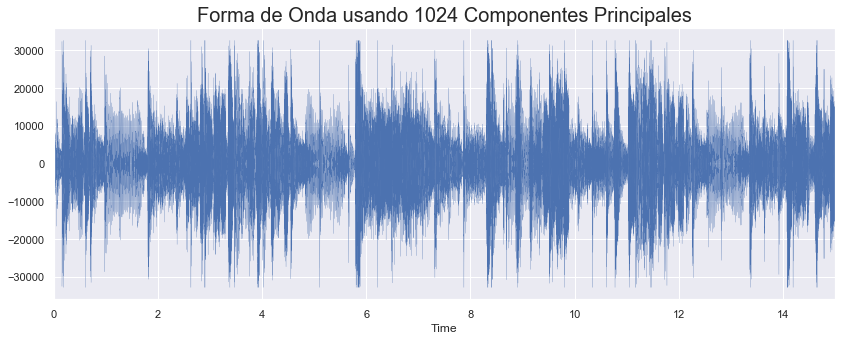

In [7]:
Original = Audio(data=reconstructed_orig[start:end], rate=samplerate)
plt.figure(figsize=(14, 5))
librosa.display.waveplot(reconstructed_orig[start:end], sr=samplerate, linewidth=.15)
plt.title("Forma de Onda usando 1024 Componentes Principales", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

In [8]:
Original

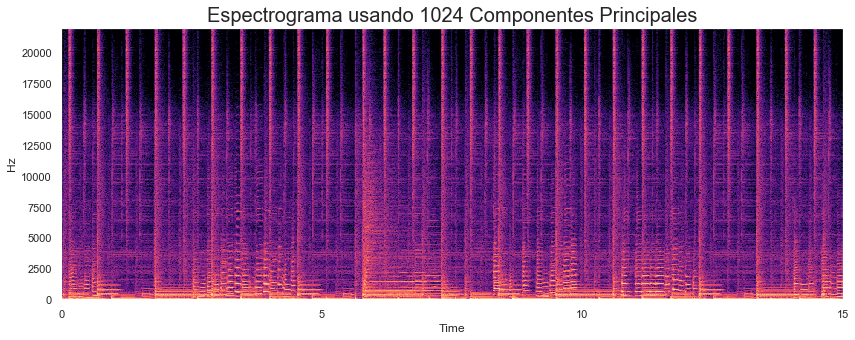

In [9]:
X_orig = librosa.stft(reconstructed_orig[start:end])
Xdb_orig = librosa.amplitude_to_db(abs(X_orig))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb_orig, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma usando 1024 Componentes Principales", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

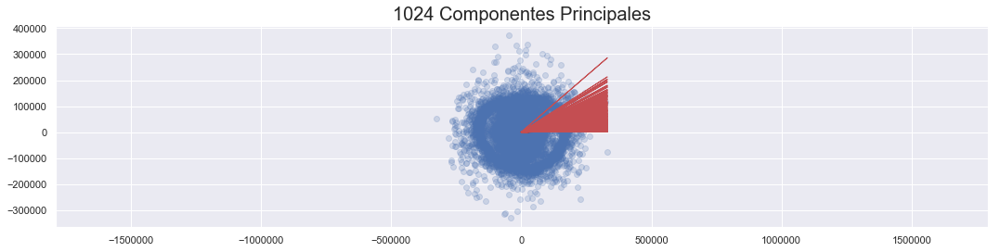

In [84]:
plt.figure(figsize=(18, 4))
plt.scatter(transformed_orig[:, 0], transformed_orig[:, 1], alpha=0.2)
for i in range(3,len(comp_orig)):
    plt.arrow(0,0,comp_orig[:,0].any()*max(transformed_orig[:, 0]),comp_orig[:,i].any()*max(transformed_orig[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("1024 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.axis('equal');
plt.show()

   ### Señal Reconstruida con 512 Componentes Principales. ### 
   A continuación mostramos la Forma de Onda, el Audio, el Espectrograma y los Componentes Principales de la señal procesada usando 512 Componentes Principales.

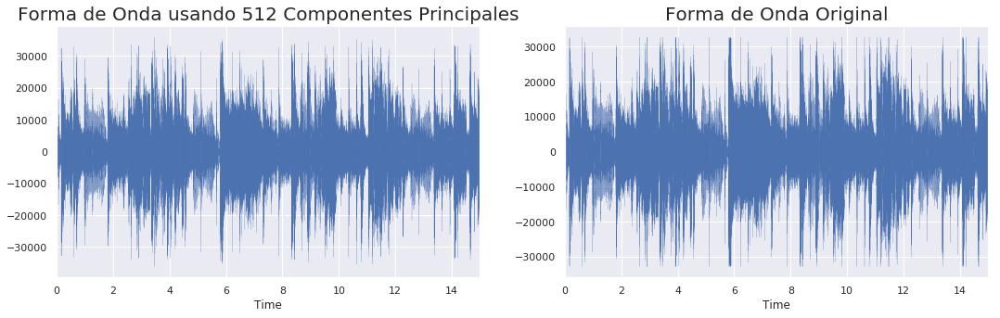

In [44]:
plt.figure(figsize=(18, 5))
plt.subplot(121)
librosa.display.waveplot(reconstructed_512[start:end], sr=samplerate, linewidth=.15)
plt.title("Forma de Onda usando 512 Componentes Principales", fontsize=20 , fontdict=None, loc='center', pad=None)

plt.subplot(122)
librosa.display.waveplot(reconstructed_orig[start:end], sr=samplerate, linewidth=.15)
plt.title("Forma de Onda Original", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

In [37]:
Comp_512 = Audio(data=reconstructed_512[start:end], rate=samplerate)
Comp_512

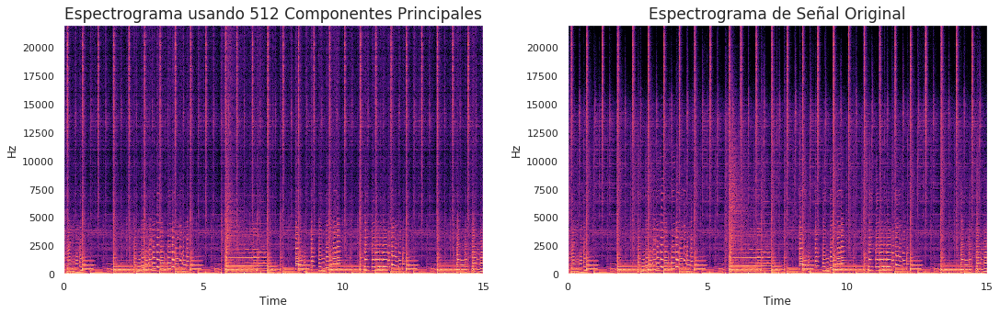

In [43]:
X_512 = librosa.stft(reconstructed_512[start:end])
Xdb_512 = librosa.amplitude_to_db(abs(X_512))

plt.figure(figsize=(18, 5))
plt.subplot(121)
librosa.display.specshow(Xdb_512, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma usando 512 Componentes Principales", fontsize=17 , fontdict=None, loc='center', pad=None)
plt.subplot(122)
librosa.display.specshow(Xdb_orig, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma de Señal Original", fontsize=17, fontdict=None, loc='center', pad=None)
plt.show()

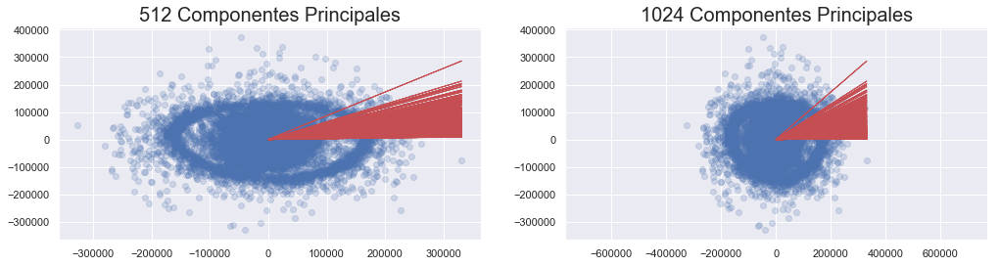

In [80]:
plt.figure(figsize=(17, 4))
plt.subplot(121)
plt.scatter(transformed_512[:, 0], transformed_512[:, 1], alpha=0.2)
for i in range(3,len(comp_512)):
    plt.arrow(0,0,comp_512[:,0].any()*max(transformed_512[:, 0]),comp_512[:,i].any()*max(transformed_512[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("512 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.grid(True)
plt.subplot(122)
plt.scatter(transformed_orig[:, 0], transformed_orig[:, 1], alpha=0.2)
for i in range(3,len(comp_orig)):
    plt.arrow(0,0,comp_orig[:,0].any()*max(transformed_orig[:, 0]),comp_orig[:,i].any()*max(transformed_orig[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("1024 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.axis('equal');
plt.show()

In [ ]:
plt.figure(figsize=(18, 4))

 <p style='text-align: justify;'> En la gráfica anterior se grafican en los ejes los primero dos componentes. Se observa un patrón que sugiere sería posible clasificar los datos en al menos dos grupos distintos; Para el análisis de audio resulta de utilidad calcular la diferencia del audio original y el audio reconstruido, de este modo es más senicllo interpretar los componentes obtenidos. La lógica a seguir es que la diferencia de los objetos representa el sonido capturado por los componentes desechados para la recontrucción.
 </p>

In [52]:
diff_orig_vs_512 = reconstructed_orig - reconstructed_512
diff_orig_vs_512_aud = Audio(data=diff_orig_vs_512[start:end], rate=samplerate)
diff_orig_vs_512_aud

 <p style='text-align: justify;'>
    Del audio anterior se aprecia que el sonido de platillos y algo de ruido blanco es capturado por los 512 componentes que fueron desechados. En términos técnicos se puede observar en el siguiente espectrograma que se trata de ruidos de alta frecuencia.
</p>

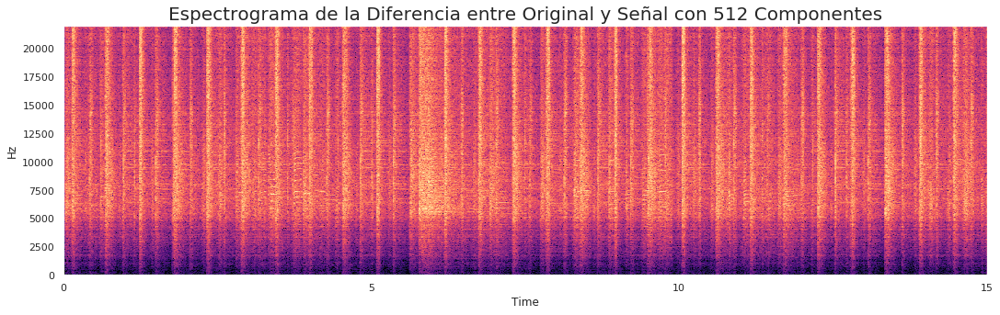

In [86]:
X_diff_orig_vs_512 = librosa.stft(diff_orig_vs_512[start:end])
Xdb_diff_orig_vs_512 = librosa.amplitude_to_db(abs(X_diff_orig_vs_512))
plt.figure(figsize=(18, 5))
librosa.display.specshow(Xdb_diff_orig_vs_512, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma de la Diferencia entre Original y Señal con 512 Componentes", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

   ### Señal Reconstruida con 204 Componentes Principales. ### 
   A continuación mostramos la Forma de Onda, el Audio, el Espectrograma y los Componentes Principales de la señal procesada usando 204 Componentes Principales.

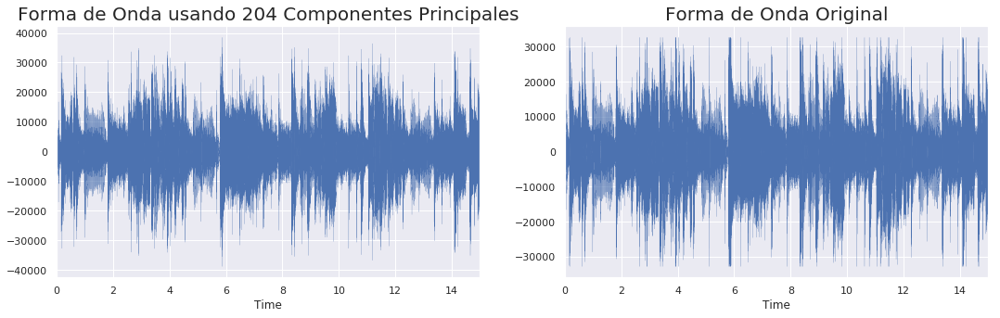

In [59]:
plt.figure(figsize=(18, 5))
plt.subplot(121)
librosa.display.waveplot(reconstructed_204[start:end], sr=samplerate, linewidth=.15)
plt.title("Forma de Onda usando 204 Componentes Principales", fontsize=20 , fontdict=None, loc='center', pad=None)

plt.subplot(122)
librosa.display.waveplot(reconstructed_orig[start:end], sr=samplerate, linewidth=.15)
plt.title("Forma de Onda Original", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

In [60]:
Comp_204 = Audio(data=reconstructed_204[start:end], rate=samplerate)
Comp_204

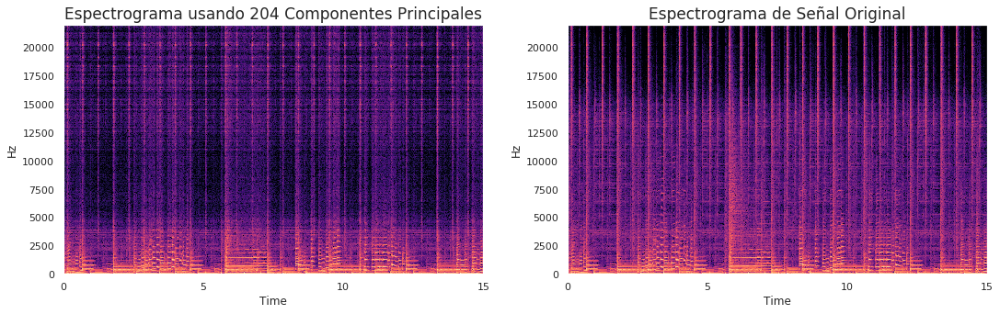

In [61]:
X_204 = librosa.stft(reconstructed_204[start:end])
Xdb_204 = librosa.amplitude_to_db(abs(X_204))
plt.figure(figsize=(18, 5))
plt.subplot(121)
librosa.display.specshow(Xdb_204, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma usando 204 Componentes Principales", fontsize=17 , fontdict=None, loc='center', pad=None)
plt.subplot(122)
librosa.display.specshow(Xdb_orig, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma de Señal Original", fontsize=17, fontdict=None, loc='center', pad=None)
plt.show()

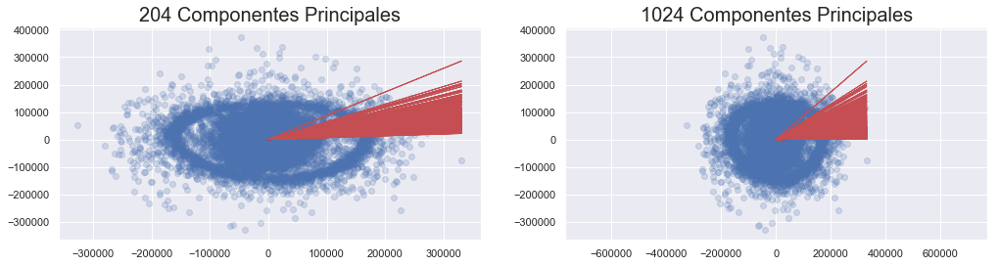

In [77]:
plt.figure(figsize=(17, 4))
plt.subplot(121)
plt.scatter(transformed_204[:, 0], transformed_204[:, 1], alpha=0.2)
for i in range(3,len(comp_204)):
    plt.arrow(0,0,comp_204[:,0].any()*max(transformed_204[:, 0]),comp_204[:,i].any()*max(transformed_204[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("204 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.grid(True)
plt.subplot(122)
plt.scatter(transformed_orig[:, 0], transformed_orig[:, 1], alpha=0.2)
for i in range(3,len(comp_orig)):
    plt.arrow(0,0,comp_orig[:,0].any()*max(transformed_orig[:, 0]),comp_orig[:,i].any()*max(transformed_orig[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("1024 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.axis('equal');
plt.show()

 <p style='text-align: justify;'> En la gráfica anterior se grafican en los ejes los primero dos componentes. Se observa un patrón que sugiere sería posible clasificar los datos en almenos dos grupos distintos; Al escuchar el objeto producto de la diferencia entre el audio original y el reconstruido se aprecia que las ondas desechadas ya no solo corresponden a los platillos y al ruido blanco; ahora se incluyen ligeras percusiones
 </p>

In [63]:
diff_orig_vs_204 = reconstructed_orig - reconstructed_204
diff_orig_vs_204_aud = Audio(data=diff_orig_vs_204[start:end], rate=samplerate)
diff_orig_vs_204_aud

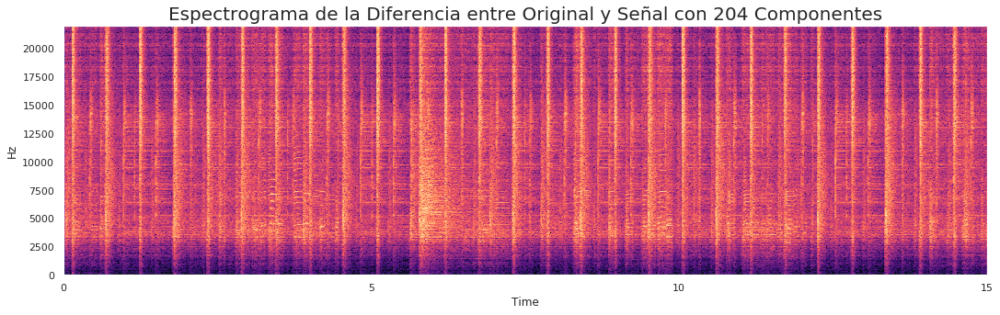

In [85]:
X_diff_orig_vs_204 = librosa.stft(diff_orig_vs_204[start:end])
Xdb_diff_orig_vs_204 = librosa.amplitude_to_db(abs(X_diff_orig_vs_204))
plt.figure(figsize=(18, 5))
librosa.display.specshow(Xdb_diff_orig_vs_204, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma de la Diferencia entre Original y Señal con 204 Componentes", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

   ### Señal Reconstruida con 16 Componentes Principales. ### 
   A continuación mostramos la Forma de Onda, el Audio, el Espectrograma y los Componentes Principales de la señal procesada usando 16 Componentes Principales.

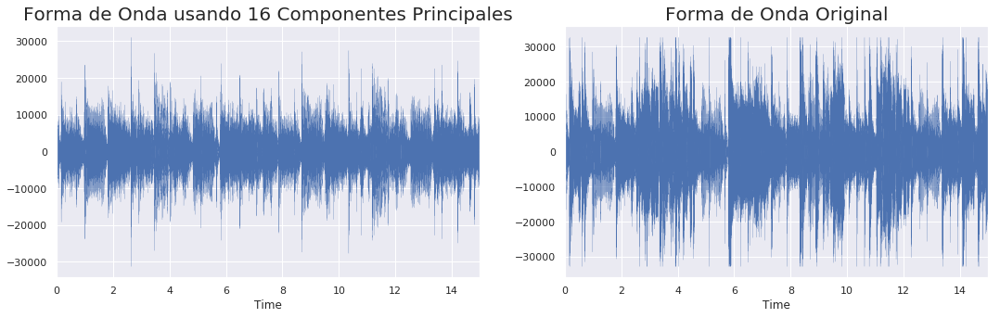

In [65]:
plt.figure(figsize=(18, 5))
plt.subplot(121)
librosa.display.waveplot(reconstructed_16[start:end], sr=samplerate, linewidth=.15)
plt.title("Forma de Onda usando 16 Componentes Principales", fontsize=20 , fontdict=None, loc='center', pad=None)

plt.subplot(122)
librosa.display.waveplot(reconstructed_orig[start:end], sr=samplerate, linewidth=.15)
plt.title("Forma de Onda Original", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

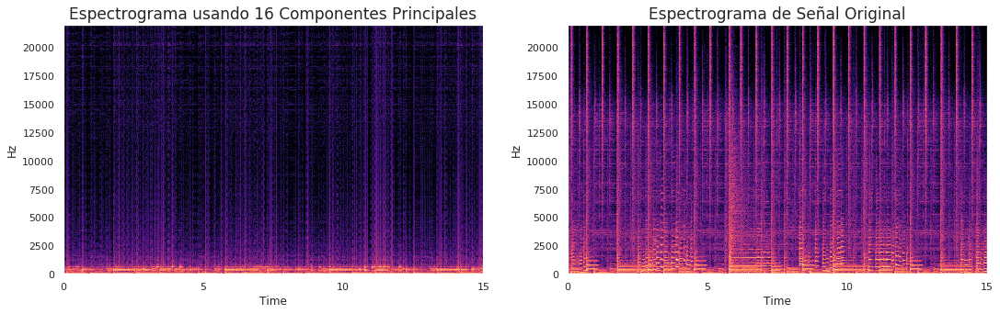

In [66]:
X_16 = librosa.stft(reconstructed_16[start:end])
Xdb_16 = librosa.amplitude_to_db(abs(X_16))

plt.figure(figsize=(18, 5))
plt.subplot(121)
librosa.display.specshow(Xdb_16, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma usando 16 Componentes Principales", fontsize=17 , fontdict=None, loc='center', pad=None)
plt.subplot(122)
librosa.display.specshow(Xdb_orig, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma de Señal Original", fontsize=17, fontdict=None, loc='center', pad=None)
plt.show()

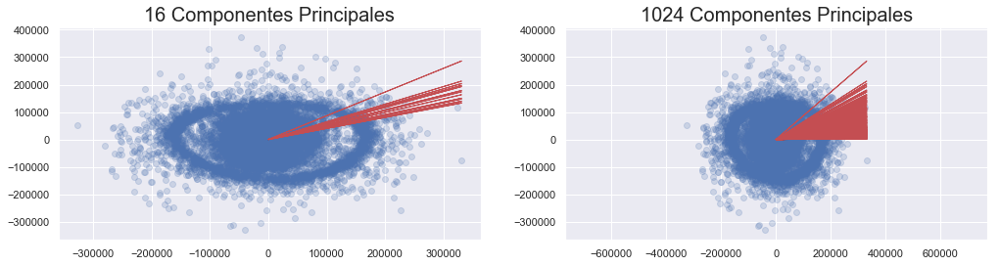

In [81]:
plt.figure(figsize=(17, 4))
plt.subplot(121)
plt.scatter(transformed_16[:, 0], transformed_16[:, 1], alpha=0.2)
for i in range(3,len(comp_16)):
    plt.arrow(0,0,comp_16[:,0].any()*max(transformed_16[:, 0]),comp_16[:,i].any()*max(transformed_16[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("16 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.grid(True)
plt.subplot(122)
plt.scatter(transformed_orig[:, 0], transformed_orig[:, 1], alpha=0.2)
for i in range(3,len(comp_orig)):
    plt.arrow(0,0,comp_orig[:,0].any()*max(transformed_orig[:, 0]),comp_orig[:,i].any()*max(transformed_orig[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("1024 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.axis('equal');
plt.show()

 <p style='text-align: justify;'> En la gráfica anterior se grafican en los ejes los primero dos componentes. Se observa un patrón que sugiere sería posible clasificar los datos en el circulo exterior; sin embargo ya son pocos los elementos observados. Al escuchar la diferencia entre los audios resulta que el objeto obtenido es prácticamente idéntico al original. Esto se debe a que los 16 componentes seleccionados captan una mínima varianza del total del conjunto. </p>

In [68]:
diff_orig_vs_16 = reconstructed_orig - reconstructed_16
diff_orig_vs_16_aud = Audio(data=diff_orig_vs_16[start:end], rate=samplerate)
diff_orig_vs_16_aud

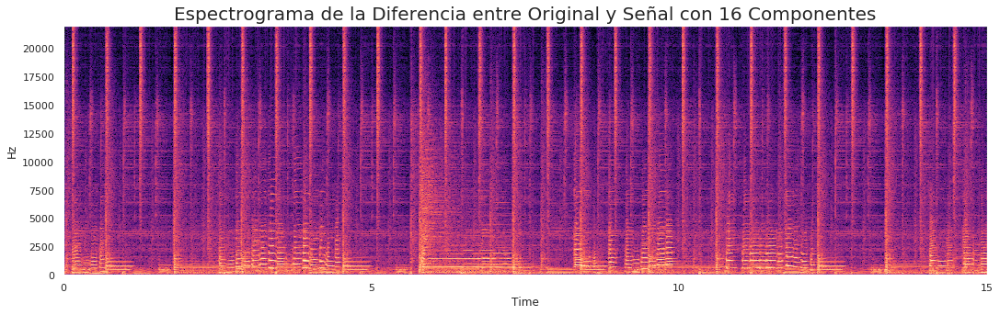

In [84]:
X_diff_orig_vs_16 = librosa.stft(diff_orig_vs_16[start:end])
Xdb_diff_orig_vs_16 = librosa.amplitude_to_db(abs(X_diff_orig_vs_16))
plt.figure(figsize=(18, 5))
librosa.display.specshow(Xdb_diff_orig_vs_16, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma de la Diferencia entre Original y Señal con 16 Componentes", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

## Varianza del 99% ##

### Scree Plot ###
Determinamos ahora el numero de componentes requeridos que expliquen el 99% de la varianza.  Proponemos una grafica de Scree para visualmente identificar la suma acumulada.

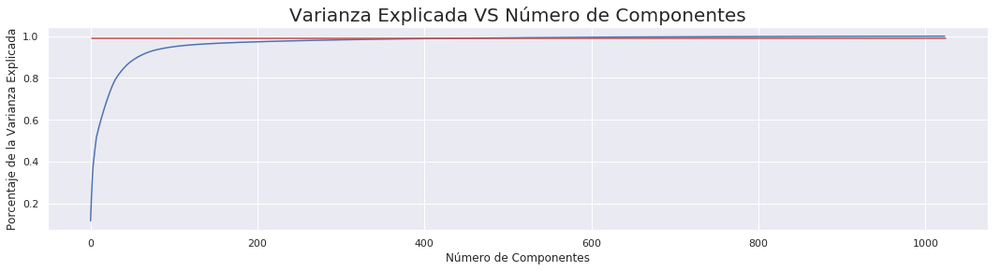

In [82]:
var=np.cumsum(expvarrat_orig)
plt.figure(figsize=(18, 4))
plt.ylabel('Porcentaje de la Varianza Explicada')
plt.xlabel('Número de Componentes')
plt.title('Varianza Explicada VS Número de Componentes', fontsize=20)
plt.plot(var)
plt.plot([1,1024],[.99,.99],color="r")
plt.show()

Vista mas cercana a la región de la gráfica donde parece intersectar el valor de 99%.

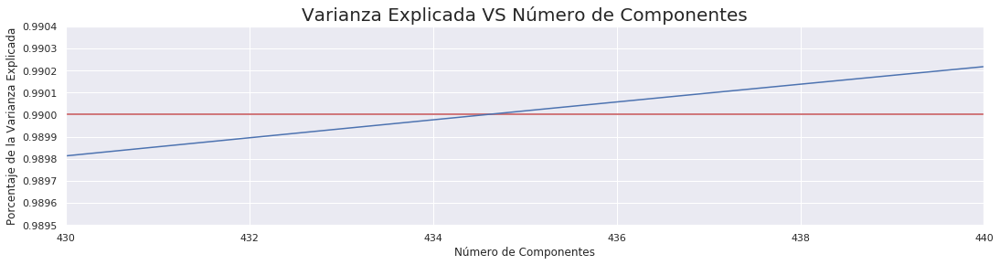

In [83]:
var=np.cumsum(expvarrat_orig)
plt.figure(figsize=(18, 4))
plt.ylabel('Porcentaje de la Varianza Explicada')
plt.xlabel('Número de Componentes')
plt.title('Varianza Explicada VS Número de Componentes', fontsize=20)
plt.ylim(.9895,.9904)
plt.xlim(430,440)
plt.plot([1,1024],[.99,.99],color="r")
plt.plot(var)
plt.show()

La varianza acumulada en el componente 435.

In [72]:
var[435]

0.9900173233615153

El número de componentes principales requeridos para considerar el 99% de la varianza son 435.

Hacemos el proceso de Descopmosición y Reconstruccion considerando 435 componentes.

In [86]:
pca_435, transformed_435, reconstructed_435, comp_435, expvar_435, mean_435, singval_435, expvarrat_435 = reducir_pca(tabulasa_left, 435, 1024)

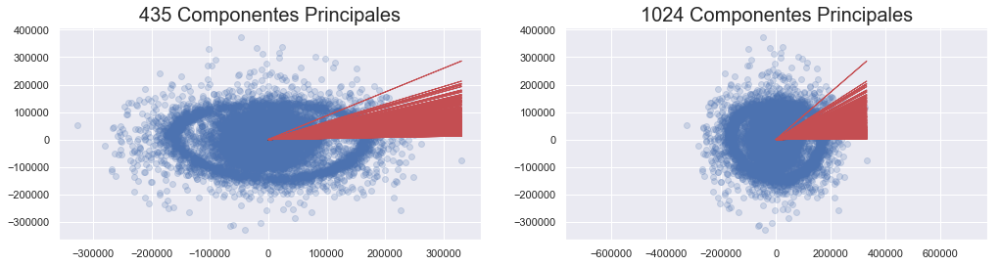

In [87]:
plt.figure(figsize=(17, 4))
plt.subplot(121)
plt.scatter(transformed_435[:, 0], transformed_435[:, 1], alpha=0.2)
for i in range(3,len(comp_435)):
    plt.arrow(0,0,comp_435[:,0].any()*max(transformed_435[:, 0]),comp_435[:,i].any()*max(transformed_435[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("435 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.grid(True)
plt.subplot(122)
plt.scatter(transformed_orig[:, 0], transformed_orig[:, 1], alpha=0.2)
for i in range(3,len(comp_orig)):
    plt.arrow(0,0,comp_orig[:,0].any()*max(transformed_orig[:, 0]),comp_orig[:,i].any()*max(transformed_orig[:, i]),color='r', width=0.0005, head_width=0.0025)
plt.title("1024 Componentes Principales", fontsize=20, fontdict=None, loc='center', pad=None)
plt.axis('equal');
plt.show()

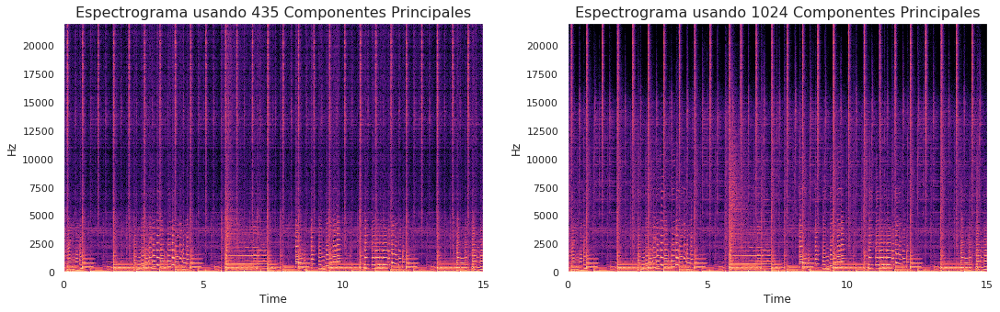

In [75]:
X_435 = librosa.stft(reconstructed_435[start:end])
Xdb_435 = librosa.amplitude_to_db(abs(X_435))

plt.figure(figsize=(18, 5))
plt.subplot(121)
librosa.display.specshow(Xdb_435, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma usando 435 Componentes Principales", fontsize=16 , fontdict=None, loc='center', pad=None)

plt.grid(True)

plt.subplot(122)
librosa.display.specshow(Xdb_orig, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma usando 1024 Componentes Principales", fontsize=16 , fontdict=None, loc='center', pad=None)
plt.show()

Aquí observamos que se pierde algo de la señal entre la banda de los $5kHz - 10kHz$ y se agrega algo de ruido que no aparece en la señal original en el rango de los $16kHz - 20kHz$ en adelante.

Escuchamos la señal recontruida con 435 componentes.

In [76]:
pca_435, transformed_435, reconstructed_435, comp_435, expvar_435, mean_435, singval_435, expvarrat_435 = reducir_pca(tabulasa_left, 435, 1024)
Comp_435 = Audio(data=reconstructed_435[start:end], rate=samplerate)
Comp_435

Observamos que tanto de la señal original le hace falta a la señal reconstruída con 435 componentes.

In [77]:
diff_orig_vs_435 = reconstructed_orig - reconstructed_435
diff_orig_vs_435_aud = Audio(data=diff_orig_vs_435[start:end], rate=samplerate)
diff_orig_vs_435_aud

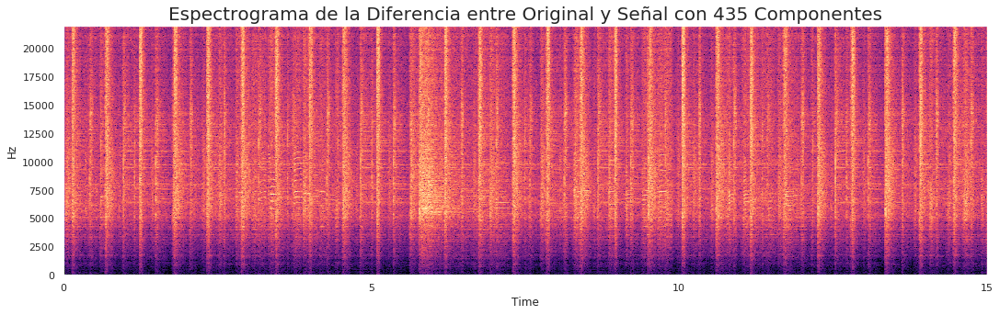

In [89]:
X_diff_orig_vs_435 = librosa.stft(diff_orig_vs_435[start:end])
Xdb_diff_orig_vs_435 = librosa.amplitude_to_db(abs(X_diff_orig_vs_435))
plt.figure(figsize=(18, 5))
librosa.display.specshow(Xdb_diff_orig_vs_435, sr=samplerate, x_axis='time', y_axis='hz')
plt.title("Espectrograma de la Diferencia entre Original y Señal con 435 Componentes", fontsize=20 , fontdict=None, loc='center', pad=None)
plt.show()

### Haciendo un tipo de "sumcheck" de las señales ###

Tomamos la diferencia entre las señales (original - la obtenida con 435 componentes) y le sumamos la señal la cual obtuvimos al reconstruir utlizando los 435 componentes principales.  En teoría deberíamos obtener la señal original pues matemáticamente estamos haciendo lo siguiente:

$$ A - B = C $$
Donde $ A = Señal \ \ Original, B = Señal \ \ Rescontruida, C = Diferencia  \ \ entre  \ \ señales $

Aqui estamos haciendo
$$ B + C $$
Pero
$$ B + C = B + (A-B) $$
Por lo que 
$$ B + C = B + A - B $$
$$ B + C = A $$


In [90]:
diff_orig_vs_435_plus_reconstructed_435 = reconstructed_435 + diff_orig_vs_435
diff_orig_vs_435_plus_reconstructed_435_aud = Audio(data=diff_orig_vs_435_plus_reconstructed_435[start:end], rate=samplerate)
diff_orig_vs_435_plus_reconstructed_435_aud

## Discusión de los resultados ##
 <p style='text-align: justify;'>Con base en las comparaciones realizadas con los distintos conjuntos de componentes principales se puede apreciar que los sonidos agudos son descartados al reconstruir las señales de audio. Sin emabrgo puede apreciarce en los espectogramas que durante la reconstrucción, el algoritmo añade ruido dentro del objeto en lugares donde, en el audio original, en la banda de 16 kHz en adelante no existía información. <br><br>

 <p style='text-align: justify;'> Se observó que los 435 componentes principales que captan el 99% de la varianza son suficientes para obtener un resultado inteligible. Sin embargo, la cuantificación del tamaño de los archvios resultado no es comparable con el original dado que los algrotimos utilizados transforman el contenido a una estructura matricial; mientras que los archivos .wav tienen un formato de señal digital específico. Para poder escuchar los productos resultado es necesario transformar la estructura matricial al mismo formato de audio (.wav) y por ende el tamaño de estos archivos resulta el mismo. Para poder aprovechar la optimización en la compresión de PCA se requeriría un codificador-decodificador de audio especializado (codec) que pueda procesar estos formatos matriciales.<br><br>
 
 <p style='text-align: justify;'>El teorema Whittaker-Nyquist-Kotelnikov-Shannon define los límites del muestreo en función a la frecuencia. Esto implica que la muestra de la onda no es identica a la original dado que existe la probabilidad que en distintos puntos del tiempo la señal presente aplanamientos debido al aliasing. Lo anterior representa que durante el periodo de muestro existe pérdida de información de las frecuencias que excedan las bandas. Para futuros trabajos valdría la pena explorar si se existe o se puede construir un algortimo que fije la amplitud óptima de las bandas y las frecuencias de muestreo como una mejora para los codificadores-decodificadores (codec) que existen en la actualidad.
 
<p style='text-align: justify;'> Por último, los resultados gráficos de las componentes principales sugieren que es posible utilizar el método conocido como Componentes Principales Funcionales si es que se desea realizar una clacificación de los datos. Valdría la pena explorar este método a fin de encontrar una manera distribuida de almanecar y procesar el audio para su transferencia.

## Referencias ##
Downey, A. B. (2016). Think DSP: digital signal processing in Python. " O'Reilly Media, Inc." <br><br>
McFee, B., Raffel, C., Liang, D., Ellis, D. P., McVicar, M., Battenberg, E., & Nieto, O. (2015, July). librosa: Audio and music signal analysis in python. In Proceedings of the 14th python in science conference (pp. 18-25). <br><br>
Smith, S. W. (1997). The scientist and engineer's guide to digital signal processing. <br><br>
McGuire, S., & Pritts, R. (2013). Audio sampling: a practical guide. Routledge. <br><br>
Sastry, Shankar. (2016). Generalized Principal Component Analysis. Springer-verlag New York.